# *Outlines*

<img src="attachment:e8d239f2-f17c-4849-8bd0-d29cf29703f0.png" width="700">


# *Loads*

We will be using loads from [WILLOW Norther Open Source Dataset](https://zenodo.org/records/11093262) for conducting this workshop

<img src="attachment:ba27de01-ee9a-4c54-9a3b-7adafb3d5c33.png" width="800">



There are various sensors installed on this turbine including accelerometers, strain gauges, fiber bragg gratings (FBGs)
<img src="attachment:3156edc7-d85c-439a-8571-910e597a4269.png" width="500">

<img src="attachment:721fa632-3483-41a3-9521-562f73827869.png">


The list of SCADA parameters and the intervals for which the data is avaliable is also given as follows:

<img src="attachment:9435b0cd-3b65-4d13-a73d-05cce0504a59.png">


<img src="attachment:eebcf6a0-2759-4b5f-81a7-c1d4bbb077f7.png">


## Loading Data

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm
tqdm.pandas() 


# codeworkspace in github repo for data--check
# Read Parquet file with Pandas: 
file_path_parked = 'NRT-WTG_Parked.parquet.gz' 
file_path_rated = 'NRT-WTG_Rated.parquet.gz' 
data_parked = pd.read_parquet(file_path_parked) 
data_rated = pd.read_parquet(file_path_rated) 

# Add case_ID column to each dataset
data_parked["case_ID"] = "parked"
data_rated["case_ID"] = "rated"

data_ = pd.concat([data_parked, data_rated]).sort_index()

data_

,MP_FBG_LATmin019_DEG255_0_nr1 [microstrain],TW_ACC_LAT069_DEG060_Y_nr2 [g],MP_FBG_LATmin017_DEG165_0_nr1 [microstrain],TP_SG_LAT014_DEG050_0_nr1 [microstrain],winddirection [°],rotorspeed [rpm],pitch [°],TW_ACC_LAT097_DEG060_Y_nr2 [g],power [kW],TP_SG_LAT014_DEG350_0_nr1 [microstrain],...,TP_ACC_LAT015_DEG240_X_nr1 [g],TP_ACC_LAT015_DEG240_Y_nr2 [g],MP_FBG_LATmin019_DEG165_0_nr1 [microstrain],TP_SG_LAT014_DEG170_0_nr1 [microstrain],TW_ACC_LAT097_DEG060_X_nr1 [g],TP_SG_LAT014_DEG230_0_nr1 [microstrain],MP_FBG_LATmin017_DEG255_0_nr1 [microstrain],TP_SG_LAT014_DEG110_0_nr1 [microstrain],TP_SG_LAT014_DEG290_0_nr1 [microstrain],case_ID
2020-07-03 01:30:00+00:00,-855.745789,0.003984,390.335541,478.673737,272.6,0.0,20.0,0.002021,-93.2,658.167175,...,-0.001281,-0.001647,283.313690,1365.870117,0.009428,702.827271,-840.999878,1981.487427,596.668701,parked
2020-07-03 01:30:00.010000+00:00,-855.945496,NaN,390.436554,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,283.313690,NaN,NaN,NaN,-840.999878,NaN,NaN,parked
2020-07-03 01:30:00.020000+00:00,-855.745789,NaN,390.032501,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,282.910980,NaN,NaN,NaN,-840.899658,NaN,NaN,parked
2020-07-03 01:30:00.030000+00:00,-856.047302,NaN,390.436554,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,283.011658,NaN,NaN,NaN,-840.999878,NaN,NaN,parked
2020-07-03 01:30:00.033333+00:00,NaN,0.004064,NaN,478.942291,NaN,NaN,NaN,0.001744,NaN,658.794373,...,-0.001347,-0.001833,NaN,1365.240601,0.009480,702.653137,NaN,1981.133179,597.028625,parked
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-07-06 00:29:59.960000+00:00,-726.318604,NaN,342.654816,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,231.866165,NaN,NaN,NaN,-714.576538,NaN,NaN,rated
2020-07-06 00:29:59.960667+00:00,NaN,0.003976,NaN,363.064758,NaN,NaN,NaN,0.004113,NaN,697.043091,...,-0.001643,0.000157,NaN,1324.979736,-0.004346,811.932556,NaN,1829.830078,745.360901,rated
2020-07-06 00:29:59.970000+00:00,-726.720032,NaN,342.957886,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,232.067535,NaN,NaN,NaN,-714.778870,NaN,NaN,rated
2020-07-06 00:29:59.980000+00:00,-726.819885,NaN,342.351776,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,231.765503,NaN,NaN,NaN,-714.778870,NaN,NaN,rated


## Data Pre-processing

In [2]:
# Drop columns containing '_FBG_' and '_ACC_'
data_ = data_.drop(columns=[col for col in data_.columns if "_FBG_" in col or "_ACC_" in col])

In [3]:
data_

,TP_SG_LAT014_DEG050_0_nr1 [microstrain],winddirection [°],rotorspeed [rpm],pitch [°],power [kW],TP_SG_LAT014_DEG350_0_nr1 [microstrain],yaw [°],windspeed [m/s],TP_SG_LAT014_DEG170_0_nr1 [microstrain],TP_SG_LAT014_DEG230_0_nr1 [microstrain],TP_SG_LAT014_DEG110_0_nr1 [microstrain],TP_SG_LAT014_DEG290_0_nr1 [microstrain],case_ID
2020-07-03 01:30:00+00:00,478.673737,272.6,0.0,20.0,-93.2,658.167175,288.4,1.6,1365.870117,702.827271,1981.487427,596.668701,parked
2020-07-03 01:30:00.010000+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,parked
2020-07-03 01:30:00.020000+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,parked
2020-07-03 01:30:00.030000+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,parked
2020-07-03 01:30:00.033333+00:00,478.942291,NaN,NaN,NaN,NaN,658.794373,NaN,NaN,1365.240601,702.653137,1981.133179,597.028625,parked
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-07-06 00:29:59.960000+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,rated
2020-07-06 00:29:59.960667+00:00,363.064758,NaN,NaN,NaN,NaN,697.043091,NaN,NaN,1324.979736,811.932556,1829.830078,745.360901,rated
2020-07-06 00:29:59.970000+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,rated
2020-07-06 00:29:59.980000+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,rated


In [4]:
# Identify different columns
sg_cols = [c for c in data_.columns if "TP_SG" in c]  # strain gauges channels
SCADA_cols = [c for c in data_.columns if c not in sg_cols]  # SCADA channels

In [5]:
# Numeric columns only
numeric_SCADA_cols = data_[SCADA_cols].select_dtypes(include='number').columns
SCADA_data = data_[numeric_SCADA_cols]
SCADA_data = SCADA_data.dropna()
# Resample numeric columns for mean and std
SCADA_resampled = (
    SCADA_data
    .resample("10min")
    .agg(["mean", "std"])
)

# Flatten MultiIndex columns
SCADA_resampled.columns = [f"{col}-{stat}" for col, stat in SCADA_resampled.columns]

# Resample case_ID separately, take the first value in each 10-min bin
case_id_resampled = data_["case_ID"].resample("10min").first()

# Combine numeric stats with case_ID
SCADA_resampled["case_ID"] = case_id_resampled

SCADA_resampled.dropna(inplace=True)
SCADA_resampled

,winddirection [°]-mean,winddirection [°]-std,rotorspeed [rpm]-mean,rotorspeed [rpm]-std,pitch [°]-mean,pitch [°]-std,power [kW]-mean,power [kW]-std,yaw [°]-mean,yaw [°]-std,windspeed [m/s]-mean,windspeed [m/s]-std,case_ID
2020-07-03 01:30:00+00:00,258.643167,7.846990,0.000000,0.000000,20.000000,0.000000,-38.324333,18.037568,261.445000,11.632077,2.022667,0.303875,parked
2020-07-03 01:40:00+00:00,253.089833,3.338596,0.000000,0.000000,20.000000,0.000000,-29.747667,1.346991,255.300000,0.000000,2.231167,0.372662,parked
2020-07-03 01:50:00+00:00,253.393000,5.232681,0.050167,0.050041,20.000000,0.000000,-28.955833,1.324320,255.300000,0.000000,2.595500,0.446799,parked
2020-07-03 02:00:00+00:00,235.677500,4.357625,0.146167,0.226135,20.000000,0.000000,-30.298833,4.177839,240.395167,10.525515,3.284333,0.400569,parked
2020-07-03 02:10:00+00:00,241.419500,8.793206,1.163500,0.139464,20.000000,0.000000,-30.560333,3.941940,236.296333,6.721956,4.042500,0.570075,parked
2020-07-03 02:20:00+00:00,245.160167,8.535717,1.285833,0.064469,20.000000,0.000000,-29.107667,1.293172,248.500000,0.000000,4.064000,0.337234,parked
2020-07-03 02:30:00+00:00,243.926667,8.049446,1.413000,0.070989,20.000000,0.000000,-32.183667,5.000845,245.197833,2.129586,4.278833,0.399083,parked
2020-07-03 02:40:00+00:00,244.243833,9.053080,1.301333,0.064848,20.000000,0.000000,-38.167167,1.152049,243.800000,0.000000,4.252333,0.399534,parked
2020-07-03 02:50:00+00:00,246.040833,9.410207,1.057500,0.112538,20.000000,0.000000,-36.807333,3.555162,243.800000,0.000000,3.590333,0.336445,parked
2020-07-03 03:00:00+00:00,250.641333,5.425171,0.900000,0.049031,20.000000,0.000000,-30.010333,3.395931,250.717667,4.884026,3.215000,0.460066,parked


In [6]:
SCADA_resampled.describe()

,winddirection [°]-mean,winddirection [°]-std,rotorspeed [rpm]-mean,rotorspeed [rpm]-std,pitch [°]-mean,pitch [°]-std,power [kW]-mean,power [kW]-std,yaw [°]-mean,yaw [°]-std,windspeed [m/s]-mean,windspeed [m/s]-std
count,22.000000,22.000000,22.000000,22.000000,22.000000,22.000000,22.000000,22.000000,22.000000,22.000000,22.000000,22.000000
mean,253.131939,5.582205,5.638265,0.106529,14.119939,0.522942,3974.492197,20.524680,253.570250,2.587012,9.139712,0.743458
std,8.602781,1.968978,5.009574,0.052428,6.037020,0.542333,4100.846207,17.525323,8.206551,3.574153,5.955683,0.359355
min,235.677500,3.338596,0.000000,0.000000,7.083000,0.000000,-38.324333,1.152049,236.296333,0.000000,2.022667,0.303875
25%,245.380333,4.301076,1.042875,0.066383,8.219708,0.000000,-30.226708,3.651857,246.023375,0.000000,3.409583,0.399793
50%,256.789333,4.611305,5.959333,0.125083,14.537083,0.455920,3969.854500,22.845758,256.650000,1.356503,9.165083,0.764829
75%,259.425667,7.241535,10.517667,0.130607,20.000000,0.973896,7977.333167,36.057355,260.307125,3.368738,14.933417,1.067342
max,264.237500,9.410207,10.521167,0.226135,20.000000,1.274396,8010.291333,47.662538,263.564167,11.632077,15.557667,1.344321


In [7]:
E = 210e9  # Pa

stress_df = data_[sg_cols] * 1e-6 * E * 1e-6  # For conversion to MPa

stress_df.columns = [col.replace("[microstrain]", "[MPa]").strip() for col in stress_df.columns]

In [8]:
stress_df.dropna(inplace=True)

In [9]:
stress_df

,TP_SG_LAT014_DEG050_0_nr1 [MPa],TP_SG_LAT014_DEG350_0_nr1 [MPa],TP_SG_LAT014_DEG170_0_nr1 [MPa],TP_SG_LAT014_DEG230_0_nr1 [MPa],TP_SG_LAT014_DEG110_0_nr1 [MPa],TP_SG_LAT014_DEG290_0_nr1 [MPa]
2020-07-03 01:30:00+00:00,100.521485,138.215107,286.832725,147.593727,416.112360,125.300427
2020-07-03 01:30:00.033333+00:00,100.577881,138.346818,286.700526,147.557159,416.037968,125.376011
2020-07-03 01:30:00.066666+00:00,100.628202,138.484733,286.573455,147.507120,415.964575,125.455979
2020-07-03 01:30:00.099999+00:00,100.685874,138.613497,286.450664,147.438906,415.903590,125.522117
2020-07-03 01:30:00.133332+00:00,100.763663,138.726687,286.321285,147.356336,415.852141,125.563735
...,...,...,...,...,...,...
2020-07-06 00:29:59.827335+00:00,76.750514,146.695215,277.918004,170.069713,384.370034,156.425685
2020-07-06 00:29:59.860668+00:00,76.547089,146.596829,278.013083,170.220983,384.299385,156.497988
2020-07-06 00:29:59.894001+00:00,76.373465,146.511119,278.096191,170.370331,384.236580,156.559858
2020-07-06 00:29:59.927334+00:00,76.269272,146.443444,278.174583,170.479792,384.217354,156.575956


In [10]:
import plotly.graph_objects as go

sg230 = stress_df['TP_SG_LAT014_DEG230_0_nr1 [MPa]']

# X-axis as minutes
x = np.arange(len(sg230)) / (30*60)   # 30 Hz → samples per second → minutes

# Build interactive plot
fig = go.Figure()

fig.add_trace(go.Scatter(
    x=x,
    y=sg230.values,
    mode="lines",
    line=dict(color="blue", width=1),
    name="Stress Signal"
))

fig.update_layout(
    title="Stress Time Series: TP_SG_LAT014_DEG230_0_nr1",
    xaxis_title="Time [minutes]",
    yaxis_title="Stress [MPa]",
    hovermode="x unified",
    template="plotly_white",
    width=1000,
    height=400
)

fig.show()

## Cycle counting the signals

We need `py_fatigue` for processing the signal into cycle_counts and further calculating fatigue damage

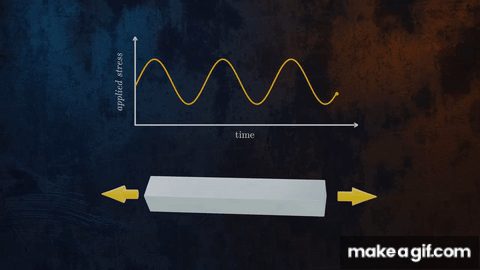

### Py-Fatigue Installing and Importing


`py_fatigue` package can be installed simply running 
`pip install py_fatigue` on the command prompt. If you want to directly install in Jupyter Notebook you can use `!pip install py_fatigue` in a code cell of Jupyter Notebook.


### Dependencies
`py_fatigue` relies on the following PyPi packages
| Package      | Version |
|--------------|---------|
| numpy        | >=1.18,<1.24    |
| plotly       | 5.6     |
| pandas       | 1.4     |
| numba        | >=0.56,<0.57    |
| matplotlib   | 3.5     |
| pydantic     | <3.0.0 |


### *[Rainflow Cycle Counting using py_fatigue](https://owi-lab.github.io/py_fatigue/user/examples/04-cycle_counting.html)*
The data-driven fatigue lifetime analysis starts with the strain signals from strain gauges that is converted to stress-time series signal. The fatigue damage calculation depends on various features of this stress-time signal i.e **stress ranges** and **number of cycles**. Other features such as mean stress also affect the fatigue damage but they are accounted using various corrections such as **DNVGL-RP-C203 mean stress effect correction**, **Walker correction** and **Smith-Watson-Topper**



The stress-time series features for fatigue damage calculation are extracted using *rainflow counting*. The working of `py_fatigue` is shown on stress-time series already imported.

#### *Extracting a short signal*

A short signal is extracted from original signal for ease of visualization and understanding of the cycle counting process. This short signal will help understand the features of stress-time signal saved in the cycle counting object of the signal.

In [13]:
import py_fatigue as pf
import warnings
warnings.filterwarnings('ignore')


start_time = sg230.index[0]
# Extracting 100 seconds of signal from original strain signal
end_time = start_time + pd.Timedelta(seconds=100)

ss_ = sg230.loc[start_time:end_time]

ts = ss_.index
ss = ss_.values


#### *Rainflow Counting a Random Signal*
Rainflow counting is performed on the timeseries signal as per following algorithm. The original signal is first converted into a reversal series (the points where a signal reverses direction) and then counted as per the below given algorithm called the **three point rainflow counting method**.

In [14]:
# Find turning points
ind_tp = pf.cycle_count.rainflow.findtp(ss)

# Build Plotly figure
fig = go.Figure()

# Original signal
fig.add_trace(go.Scatter(
    x=ts, y=ss,
    mode='lines',
    name='Stress Signal',
    line=dict(color='blue')
))

# Turning points
fig.add_trace(go.Scatter(
    x=ts[ind_tp], y=ss[ind_tp],
    mode='markers+text',
    name='Turning Points',
    marker=dict(color='red', size=8, symbol="circle"),
    textposition="top center"
))

fig.update_layout(
    title="Interactive Stress Signal with Turning Points",
    xaxis_title="Time",
    yaxis_title="Stress [MPa]",
    hovermode="x unified"
)

fig.show()

In [15]:
ss[ind_tp] # We see closely spaced reversals at 142.2--> Inspect using the plot

array([147.59372681, 142.19190491, 147.78650024, 142.28702271,
       142.29017578, 142.28613831, 147.78621826, 142.11002747,
       147.73339783, 142.37884644, 147.61633667, 142.61941589,
       146.93992493, 143.51810669, 143.5198114 , 143.51801697,
       146.11842041, 144.05243774, 146.06347229, 143.99848938,
       146.01339478, 143.93727356, 146.3778186 , 143.33170349,
       146.99794922, 142.94052979, 146.93672058, 143.41354248,
       146.45861938, 143.65463745, 143.6984729 , 143.69715271,
       146.7635321 , 142.98421143, 147.0850177 , 143.33712524,
       146.44930115, 143.60772583, 146.83577087, 142.80405029,
       147.03124878, 143.35345459, 145.97517334, 145.91254761,
       145.9147522 , 144.01040955, 146.12013794, 146.07109863,
       146.07156006, 143.54322876, 146.36136108, 143.76259827,
       143.76664856, 143.75886841, 145.54757263, 145.53701111,
       145.54338135, 144.65781555, 144.65912292, 144.57789917,
       144.81263672, 144.80251099, 144.83802795, 144.81


<img src="attachment:b635d4e7-f4d5-49a3-a249-94a3f7d78728.PNG" width="800">


<img src="attachment:fe64b7a8-abb3-4cec-8a1b-8dc2202b1f67.png" width="1000">


The **Cycle Count Matrix from Timeseries Signal** is generated using `pf.CycleCount`. The timeseries stress signal is fed to `pf.CycleCount.from_timeseries()` method to get a cycle_count matrix. The implementation is shown on the short demo signal generated above.

In [16]:
# CycleCount definition
cycle_count_test = pf.CycleCount.from_timeseries(
    data=ss, mean_bin_width=3, range_bin_width=3,
)
cycle_count_test

,None
Cycle counting object,
"largest full stress range, MPa",5.50008
"largest stress range, MPa",5.676473
number of full cycles,33
number of residuals,16
number of small cycles,0
stress concentration factor,N/A
residuals resolved,False
mean stress-corrected,No


The cycle counting matrix as seen above summarizes the time series signal in the form of number of cycles (completed/ closed cycles) categorized as large and small cycles, number of residuals, number of small cycles etc. Please note that the largest stress range could be from the half cycles. These details will be discussed more in detail in coming sections.

The cycle_count object can be converted into pandas dataframe using `cc.to_df()` method. The dataframe shows the full and half (residual) cycles along with their respective mean stress values and stress ranges without binning.

In [17]:
cycle_count_test.to_df().head()

,count_cycle,mean_stress,stress_range
0,0.5,144.892816,5.401822
1,1.0,142.288599,0.003153
2,1.0,145.036178,5.500080
3,0.5,144.989203,5.594595
4,1.0,143.518959,0.001705


The cycle_count instance is usually exported as a dictionary using `cc.as_dict()` method. The dictionary of cc object saves the mean stress, stress range of full and half (residual) cycles. This method bins the data for cycles. The residual signal sequence is also saved in dictionary.

In [18]:
exp_dict = cycle_count_test.as_dict(max_consecutive_zeros=20, damage_tolerance_for_binning=1)
exp_dict

{'nr_small_cycles': 17,
 'range_bin_lower_bound': 0.2,
 'range_bin_width': 3,
 'mean_bin_lower_bound': 139.5,
 'mean_bin_width': 3,
 'hist': [[], [11.0, 6.0], []],
 'lg_c': [],
 'res': [[144.8928, 5.4018],
  [144.9892, 5.5946],
  [144.9483, 5.6765],
  [144.9217, 5.6234],
  [145.0561, 5.3546],
  [144.9976, 5.2375],
  [145.1179, 4.9969],
  [144.8522, 4.4656],
  [144.9445, 4.281],
  [144.9176, 4.2272],
  [145.1924, 3.6778],
  [144.8574, 3.0079],
  [144.9695, 2.7838],
  [144.7261, 2.2971],
  [144.9741, 1.801]],
 'res_sig': [147.5937,
  142.1919,
  147.7865,
  142.11,
  147.7334,
  142.3788,
  147.6163,
  142.6194,
  147.085,
  142.8041,
  147.0312,
  143.3535,
  146.3614,
  143.5775,
  145.8746,
  144.0736,
  144.1525]}

In [19]:
# Reconstructing the CycleCount instance from the exported matrix
cycle_count_d = pf.CycleCount.from_rainflow(exp_dict, name="Short Signal")
cycle_count_d

,Short Signal
Cycle counting object,
"largest full stress range, MPa",4.7
"largest stress range, MPa",5.6765
number of full cycles,17
number of residuals,15
number of small cycles,17
stress concentration factor,N/A
residuals resolved,False
mean stress-corrected,No


The dictionary of the `cycle_count` object can be exported into `.json` file to be saved on a local hard drive. This `.json` file can be exported back to regenerated `cycle_count` object.

The cycle count instance can be regenerated from the exported dictionary using `CycleCount.from_rainflow()` method.

It is interesting to note that the residual reversals in sequence is also saved in the cycle count object along with the residual cycels and can be plotted to visualize as given below.

(<Figure size 1000x400 with 1 Axes>,
 <Axes: xlabel='Residuals sequence', ylabel='Residuals'>)

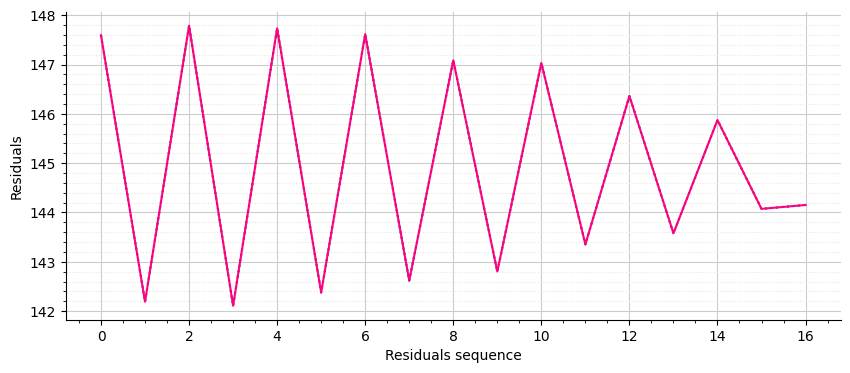

In [20]:
fig = plt.figure(figsize=(10, 4))
cycle_count_test.plot_residuals_sequence(label='Cycle Count Signal', fig=fig)

Now that we have seen the application of `CycleCount` method on a rather simple signal, we will now implement it on a much longer signal to get some reasonable values of damage. Let's use the complete signal to apply `CycleCount` method on it following the same methodology as before

**We can apply cycle counting on complete signal at once but that poses a few practical limitations**

1: cycle counting long signals is time consuming

2: With each second of incoming new signal, we need to reprocess the whole time series and perform cycle counting

3: Industry standard to store results in 10-minute intervals and is adopted for SHM as well.

4: Easier to store/ retrieve 10-minute cycle counts and add them up to regenerate cycle count of whole signal.


<img src="attachment:7609d45e-b23c-4798-bc11-cfd170d6aa31.png" width="800">



In [21]:
def count_cycles(block):
    cycle_counts = {}

    if block.empty:
        return {col: None for col in block.columns}  # return None for all columns

    # numeric time in seconds since start of block
    ts = (block.index.view("int64") / 1e9)
#    ts = ts - ts[0]  # optional: start from 0

    block_timestamp = block.index[0].to_pydatetime()  # safe now

    for col in block.columns:
        ss = block[col].values
        if len(ss) == 0 or np.all(np.isnan(ss)):
            cycle_counts[col] = None
            continue
        try:
            clean_name = col.replace("[microstrain]", "").strip()
            cc = pf.CycleCount.from_timeseries(
                data=ss,
                time=ts,
                timestamp=block_timestamp,
                name=clean_name,
                unit="MPa"
            )
            cycle_counts[col] = cc
        except Exception as e:
            cycle_counts[col] = None
    return cycle_counts


In [22]:
stress_resampled = (
    stress_df
    .groupby(pd.Grouper(freq="10min"))
    .apply(count_cycles)
)
# Convert Series of dicts into DataFrame
stress_resampled = stress_resampled.apply(pd.Series)
stress_resampled.dropna(inplace=True)


In [23]:
stress_resampled

,TP_SG_LAT014_DEG050_0_nr1 [MPa],TP_SG_LAT014_DEG350_0_nr1 [MPa],TP_SG_LAT014_DEG170_0_nr1 [MPa],TP_SG_LAT014_DEG230_0_nr1 [MPa],TP_SG_LAT014_DEG110_0_nr1 [MPa],TP_SG_LAT014_DEG290_0_nr1 [MPa]
2020-07-03 01:30:00+00:00,CC_TP_SG_LAT014_DEG050_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG350_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG170_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG230_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG110_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG290_0_nr1 [MPa] (03 Jul 202...
2020-07-03 01:40:00+00:00,CC_TP_SG_LAT014_DEG050_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG350_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG170_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG230_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG110_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG290_0_nr1 [MPa] (03 Jul 202...
2020-07-03 01:50:00+00:00,CC_TP_SG_LAT014_DEG050_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG350_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG170_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG230_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG110_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG290_0_nr1 [MPa] (03 Jul 202...
2020-07-03 02:00:00+00:00,CC_TP_SG_LAT014_DEG050_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG350_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG170_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG230_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG110_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG290_0_nr1 [MPa] (03 Jul 202...
2020-07-03 02:10:00+00:00,CC_TP_SG_LAT014_DEG050_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG350_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG170_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG230_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG110_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG290_0_nr1 [MPa] (03 Jul 202...
2020-07-03 02:20:00+00:00,CC_TP_SG_LAT014_DEG050_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG350_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG170_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG230_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG110_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG290_0_nr1 [MPa] (03 Jul 202...
2020-07-03 02:30:00+00:00,CC_TP_SG_LAT014_DEG050_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG350_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG170_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG230_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG110_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG290_0_nr1 [MPa] (03 Jul 202...
2020-07-03 02:40:00+00:00,CC_TP_SG_LAT014_DEG050_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG350_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG170_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG230_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG110_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG290_0_nr1 [MPa] (03 Jul 202...
2020-07-03 02:50:00+00:00,CC_TP_SG_LAT014_DEG050_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG350_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG170_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG230_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG110_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG290_0_nr1 [MPa] (03 Jul 202...
2020-07-03 03:00:00+00:00,CC_TP_SG_LAT014_DEG050_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG350_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG170_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG230_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG110_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG290_0_nr1 [MPa] (03 Jul 202...


In [24]:
data_processed = pd.concat(
    [SCADA_resampled, stress_resampled.add_prefix("CC_")],
    axis=1
)

data_processed

,winddirection [°]-mean,winddirection [°]-std,rotorspeed [rpm]-mean,rotorspeed [rpm]-std,pitch [°]-mean,pitch [°]-std,power [kW]-mean,power [kW]-std,yaw [°]-mean,yaw [°]-std,windspeed [m/s]-mean,windspeed [m/s]-std,case_ID,CC_TP_SG_LAT014_DEG050_0_nr1 [MPa],CC_TP_SG_LAT014_DEG350_0_nr1 [MPa],CC_TP_SG_LAT014_DEG170_0_nr1 [MPa],CC_TP_SG_LAT014_DEG230_0_nr1 [MPa],CC_TP_SG_LAT014_DEG110_0_nr1 [MPa],CC_TP_SG_LAT014_DEG290_0_nr1 [MPa]
2020-07-03 01:30:00+00:00,258.643167,7.846990,0.000000,0.000000,20.000000,0.000000,-38.324333,18.037568,261.445000,11.632077,2.022667,0.303875,parked,CC_TP_SG_LAT014_DEG050_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG350_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG170_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG230_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG110_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG290_0_nr1 [MPa] (03 Jul 202...
2020-07-03 01:40:00+00:00,253.089833,3.338596,0.000000,0.000000,20.000000,0.000000,-29.747667,1.346991,255.300000,0.000000,2.231167,0.372662,parked,CC_TP_SG_LAT014_DEG050_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG350_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG170_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG230_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG110_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG290_0_nr1 [MPa] (03 Jul 202...
2020-07-03 01:50:00+00:00,253.393000,5.232681,0.050167,0.050041,20.000000,0.000000,-28.955833,1.324320,255.300000,0.000000,2.595500,0.446799,parked,CC_TP_SG_LAT014_DEG050_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG350_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG170_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG230_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG110_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG290_0_nr1 [MPa] (03 Jul 202...
2020-07-03 02:00:00+00:00,235.677500,4.357625,0.146167,0.226135,20.000000,0.000000,-30.298833,4.177839,240.395167,10.525515,3.284333,0.400569,parked,CC_TP_SG_LAT014_DEG050_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG350_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG170_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG230_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG110_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG290_0_nr1 [MPa] (03 Jul 202...
2020-07-03 02:10:00+00:00,241.419500,8.793206,1.163500,0.139464,20.000000,0.000000,-30.560333,3.941940,236.296333,6.721956,4.042500,0.570075,parked,CC_TP_SG_LAT014_DEG050_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG350_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG170_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG230_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG110_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG290_0_nr1 [MPa] (03 Jul 202...
2020-07-03 02:20:00+00:00,245.160167,8.535717,1.285833,0.064469,20.000000,0.000000,-29.107667,1.293172,248.500000,0.000000,4.064000,0.337234,parked,CC_TP_SG_LAT014_DEG050_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG350_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG170_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG230_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG110_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG290_0_nr1 [MPa] (03 Jul 202...
2020-07-03 02:30:00+00:00,243.926667,8.049446,1.413000,0.070989,20.000000,0.000000,-32.183667,5.000845,245.197833,2.129586,4.278833,0.399083,parked,CC_TP_SG_LAT014_DEG050_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG350_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG170_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG230_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG110_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG290_0_nr1 [MPa] (03 Jul 202...
2020-07-03 02:40:00+00:00,244.243833,9.053080,1.301333,0.064848,20.000000,0.000000,-38.167167,1.152049,243.800000,0.000000,4.252333,0.399534,parked,CC_TP_SG_LAT014_DEG050_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG350_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG170_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG230_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG110_0_nr1 [MPa] (03 Jul 202...,CC_TP_SG_LAT014_DEG290_0_nr1 [

In [25]:
# Find all columns containing '_DEG230_'
deg230_cols = [col for col in data_processed.columns if "_DEG230_" in col]

# Select only those columns
deg230_data = data_processed[deg230_cols]
deg230_data

,CC_TP_SG_LAT014_DEG230_0_nr1 [MPa]
2020-07-03 01:30:00+00:00,CC_TP_SG_LAT014_DEG230_0_nr1 [MPa] (03 Jul 202...
2020-07-03 01:40:00+00:00,CC_TP_SG_LAT014_DEG230_0_nr1 [MPa] (03 Jul 202...
2020-07-03 01:50:00+00:00,CC_TP_SG_LAT014_DEG230_0_nr1 [MPa] (03 Jul 202...
2020-07-03 02:00:00+00:00,CC_TP_SG_LAT014_DEG230_0_nr1 [MPa] (03 Jul 202...
2020-07-03 02:10:00+00:00,CC_TP_SG_LAT014_DEG230_0_nr1 [MPa] (03 Jul 202...
2020-07-03 02:20:00+00:00,CC_TP_SG_LAT014_DEG230_0_nr1 [MPa] (03 Jul 202...
2020-07-03 02:30:00+00:00,CC_TP_SG_LAT014_DEG230_0_nr1 [MPa] (03 Jul 202...
2020-07-03 02:40:00+00:00,CC_TP_SG_LAT014_DEG230_0_nr1 [MPa] (03 Jul 202...
2020-07-03 02:50:00+00:00,CC_TP_SG_LAT014_DEG230_0_nr1 [MPa] (03 Jul 202...
2020-07-03 03:00:00+00:00,CC_TP_SG_LAT014_DEG230_0_nr1 [MPa] (03 Jul 202...


## [Low Frequency Fatigue Dynamics](https://wes.copernicus.org/articles/8/1839/2023/)

In [26]:
#Resolved residuals in cycle counted objects
NR_CC = data_processed['CC_TP_SG_LAT014_DEG230_0_nr1 [MPa]'].sum()
RR_CC = NR_CC.resolve_residuals()
NR_CC

,TP_SG_LAT014_DEG230_0_nr1 [MPa]
Cycle counting object,
"largest full stress range, MPa",14.915934
"largest stress range, MPa",19.070099
number of full cycles,13396
number of residuals,384
number of small cycles,0
stress concentration factor,N/A
residuals resolved,False
mean stress-corrected,No


In [27]:
RR_CC

,TP_SG_LAT014_DEG230_0_nr1 [MPa]
Cycle counting object,
"largest full stress range, MPa",17.034161
"largest stress range, MPa",43.390596
number of full cycles,13568
number of residuals,22
number of small cycles,0
stress concentration factor,N/A
residuals resolved,True
mean stress-corrected,No


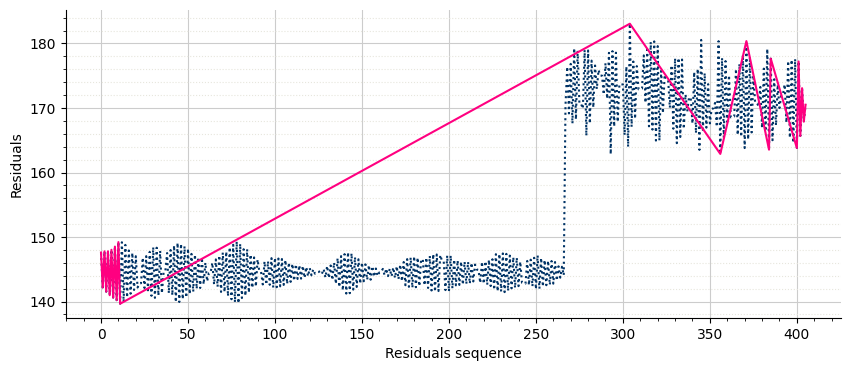

In [28]:
fig = plt.figure(figsize=(10, 4))
NR_CC.plot_residuals_sequence(label='Cycle Count Signal', fig = fig)
plt.show()

In [29]:
ss = stress_df['TP_SG_LAT014_DEG230_0_nr1 [MPa]']
cc = pf.CycleCount.from_timeseries(
    data=ss.values,
    name="From complete signal",
    unit="MPa"
)

cc

,From complete signal
Cycle counting object,
"largest full stress range, MPa",17.034161
"largest stress range, MPa",43.390596
number of full cycles,13568
number of residuals,22
number of small cycles,0
stress concentration factor,N/A
residuals resolved,False
mean stress-corrected,No


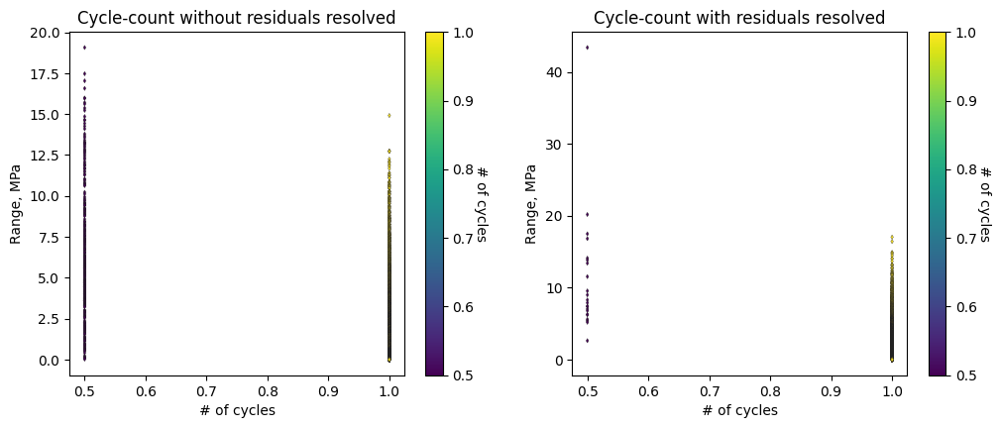

In [31]:

fig, axs = plt.subplots(1, 2, figsize=(12, 4.5))
NR_CC.plot_histogram(fig=fig, ax=axs[0], plot_type="counts-range-2D",
                           marker="d", s=5, edgecolors="#222",
                             linewidth=0.25)
axs[0].set_title("Cycle-count without residuals resolved")
RR_CC.plot_histogram(fig=fig, ax=axs[1], plot_type="counts-range-2D",
                             marker="d", s=5, edgecolors="#222",
                             linewidth=0.25)
axs[1].set_title("Cycle-count with residuals resolved")
plt.show()

**Why Does it matter???**

<img src="attachment:47a55719-1e5c-4697-b84a-9876320faf58.png" width="800">

Share of the low-frequency cycles of various lengths in the final LFFD factor of T1 after 3 years. Damages are normalized to 100 %. (Without LFFD: T, daily: D, weekly: W, monthly: M, quarterly: Q, and yearly: Y).


**How can we account for LFFD?**

<img src="attachment:8e3b6171-ad8d-48e0-83d6-36faa14029c9.png" width="800">

Trend in LFFD factor along the circumference of T1 over time using 3 years of SHM data, plus the results of Marsh et al. (2016). The solid grey line shows the average of the converged values of all sensors, and the grey area is the average ± 2 SDs. (b) Comparison of the LFFD factor value from FA and SS and the average of the sensors for m=5.

<img src="attachment:f98e4547-f529-4f24-9a22-48cb1aee147b.png" width="800">

Average of the stabilized LFFD factors after 9 months for the six positions along the circumference and FA and SS, for T1 of Farm 1 and T2, T3, and T4 of Farm 2. Each box is for an SN curve slope

## *Static Extrapolation of Loads*
Till now, we have not considered any stress concentration factor in the cycle counting objects. These factors are important for **Stress Transformation to other locations**, **Incorporatethe effect of geometrical irregularities** and **include the effect of welds in the structure**

Consider a cantilever beam with varying cross-section and a point load applied at the tip as shown in Figure 2. The bending moment diagram in the cantilever beam is also shown.

The signal we have been using so far was stress signal measured at Section A-A of the given beam. We now have the measured stresses at Section A-A. From the bending moment diagram we notice that Section A-A is not the most critical location in the beam. At Section B-B, the bending moment is higher and there is a circumferential weld at that section as well. 

The stress signal needs to be transformed to Section B-B for calculation of the accumulated damage at Section B-B. Suppose from design, we know the bending moment diagram for the beam subjected to operation load **F** at the tip. The bending moment ratio at section A-A and section B-B is calculated as the load extrapolation factor shown in `Figure 2`. Similarly, the cross-sectional details at section A-A and section B-B are not the same. Thus, a stress extrapolation factor incorporating the effect of varying radius and second moment of area of the sections is calculated as shown in `Figure 2`. The circumferential weld at section B-B introduces a geometric irregularity and thus is accounted for a stress concentration factor. Finally a materials safety factor as per design is also included in the calculations.

<img src="attachment:4707dad7-281e-45f1-9c66-21567ad0458e.png" width="800">

<div align="center"><em>Figure 2: Bending Moment Diagram of a Beam Illustration and Static Extrapolation Factor</em></div>

All these factors are accumulated in a single **Stress Multiplication Factor** which is used for scaling the `cycle_count` objects and thus for accumulated damage calculation at Section B-B.

In [32]:
RR_CC

,TP_SG_LAT014_DEG230_0_nr1 [MPa]
Cycle counting object,
"largest full stress range, MPa",17.034161
"largest stress range, MPa",43.390596
number of full cycles,13568
number of residuals,22
number of small cycles,0
stress concentration factor,N/A
residuals resolved,True
mean stress-corrected,No


In [33]:
SMF = 4.05 #Stress Multiplication Factor
RR_CC*SMF

,"TP_SG_LAT014_DEG230_0_nr1 [MPa], SCF=4.05"
Cycle counting object,
"largest full stress range, MPa",68.988351
"largest stress range, MPa",175.731915
number of full cycles,13568
number of residuals,22
number of small cycles,0
stress concentration factor,4.05
residuals resolved,True
mean stress-corrected,No


# Defining OWI MetaDataBase Credentials

In [37]:
#import json
import os
#import requests
import dotenv
from owimetadatabase_preprocessor.locations.io import LocationsAPI
from owimetadatabase_preprocessor.fatigue.io import FatigueAPI
from owimetadatabase_preprocessor.geometry.io import GeometryAPI

In [38]:
## Credentials for Metadatabase
dotenv.load_dotenv()

api_root = 'https://owimetadatabase-dev.azurewebsites.net/api/v1'
TOKEN = os.getenv('OWIMETA_TOKEN')
head = {'Authorization': 'Token %s' % (TOKEN)}
api_geo = GeometryAPI(api_root=api_root, token=TOKEN)
#api_geo = GeometryAPI(api_root=api_root, uname=user,password=password)

## Geometry APIs

In [39]:
turbine_ID = 'NRTC3'

owts = api_geo.get_owt_geometry_processor(turbine_ID)
owts.process_structures()

In [40]:
list(owts.__dict__.keys())

['owts',
 'api',
 'materials',
 'sub_assemblies',
 'tower_base',
 'pile_head',
 'water_depth',
 'tw_sub_assemblies',
 'tp_sub_assemblies',
 'mp_sub_assemblies',
 'pile_toe',
 'rna',
 'tower',
 'transition_piece',
 'monopile',
 'tw_lumped_mass',
 'tp_lumped_mass',
 'mp_lumped_mass',
 'tp_distributed_mass',
 'mp_distributed_mass',
 'grout',
 'full_structure',
 'tp_skirt',
 'substructure',
 'all_tubular_structures',
 'all_distributed_mass',
 'all_lumped_mass',
 'all_turbines',
 '_init']

In [41]:
owts.all_turbines

,Turbine name,Water depth [m],Monopile toe [m],Monopile head [m],Tower base [m],Monopile height [m],Monopile mass [t],Transition piece height [m],Transition piece mass [t],Tower height [m],Tower mass [t],RNA mass [t]
0,NRTC3,-23.35,-48.45,8.0,17.6,56.45,641.52,20.88,267.44,86.36,432.63,479.51


In [42]:
data, layout = owts.sub_assemblies[turbine_ID]['MP'].plotly()
fig = go.Figure(data=data, layout=layout)
# Set figure size in pixels
fig.update_layout(width=600, height=600)

fig.show()

In [43]:
owts.monopile

,Elevation from [mLAT],Elevation to [mLAT],Height [m],Diameter from [m],Diameter to [m],Volume [m3],Wall thickness [mm],Youngs modulus [GPa],Poissons ratio [-],Mass [t],rho [t/m],Subassembly
title,,,,,,,,,,,,
nrtc3_mp_00,8.000,7.705,0.295,6.500,6.500,0.475989,80.0,210,0.3,3.7365,12.666102,MP
nrtc3_mp_01,7.705,5.705,2.000,6.500,6.500,3.227044,80.0,210,0.3,25.3323,12.666150,MP
nrtc3_mp_02,5.705,2.720,2.985,6.500,6.500,3.623526,60.0,210,0.3,28.4447,9.529213,MP
nrtc3_mp_03,2.720,-0.280,3.000,6.500,6.500,3.641734,60.0,210,0.3,28.5876,9.529200,MP
nrtc3_mp_04,-0.280,-3.780,3.500,6.500,6.726,4.323240,60.0,210,0.3,33.9374,9.696400,MP
nrtc3_mp_05,-3.780,-6.780,3.000,6.726,6.919,3.824104,60.0,210,0.3,30.0192,10.006400,MP
nrtc3_mp_06,-6.780,-8.950,2.170,6.919,7.059,2.834206,60.0,210,0.3,22.2485,10.252765,MP
nrtc3_mp_07,-8.950,-11.120,2.170,7.059,7.200,2.891676,60.0,210,0.3,22.6997,10.460691,MP
nrtc3_mp_08,-11.120,-13.670,2.550,7.200,7.200,3.431939,60.0,210,0.3,26.9407,10.564980,MP


**Check the sensors location to calculate stress extrapolation factor**

In [44]:
d_A = owts.transition_piece.at['nrtc3_tp_03', 'Diameter from [m]']
d_A

6.5

In [45]:
t_A = owts.transition_piece.at['nrtc3_tp_03', 'Wall thickness [mm]']
t_A

69.0

In [46]:
d_B = owts.monopile.at['nrtc3_mp_11', 'Diameter from [m]']
d_B

7.2

In [47]:
t_B = owts.monopile.at['nrtc3_mp_11', 'Wall thickness [mm]']
t_B

68.0

In [48]:
def moment_of_inertia(diameter, thickness):
    """
    Calculate the second moment of area (I) for a hollow circular section.
    
    Parameters
    ----------
    diameter : float
        Outer diameter in meters.
    thickness : float
        Wall thickness in millimeters.
    
    Returns
    -------
    float
        Moment of inertia (m⁴)
    """
    I = (np.pi * (diameter**4 - (diameter - 2 * (thickness / 1000))**4) / 64)
    return I

In [49]:
I_A = moment_of_inertia(d_A, t_A)
I_B = moment_of_inertia(d_B, t_B)

SEF = (I_A*0.5*d_B)/(I_B*0.5*d_A)
SEF

0.8240837617809424

# Resistance

## *Fatigue APIs*

In [50]:
api_fatigue = FatigueAPI(api_root=api_root, token=TOKEN)

In [51]:
sncurves = api_fatigue.get_sncurves()
sncurve = sncurves[0]
print(f"Total number of accessible SN curves in the database currently is {len(sncurves)}.")

Total number of accessible SN curves in the database currently is 210.


In [52]:
sncurves

[DNVGL-RP-C203/2016: B1 - Air,
 DNVGL-RP-C203/2016: B1 - Air,
 DNVGL-RP-C203/2016: B1 - Air,
 DNVGL-RP-C203/2016: B1 - Air,
 DNVGL-RP-C203/2016: B1 - Air,
 DNVGL-RP-C203/2016: B2 - Air,
 DNVGL-RP-C203/2016: B2 - Air,
 DNVGL-RP-C203/2016: B2 - Air,
 DNVGL-RP-C203/2016: B2 - Air,
 DNVGL-RP-C203/2016: B2 - Air,
 DNVGL-RP-C203/2016: C - Air,
 DNVGL-RP-C203/2016: C - Air,
 DNVGL-RP-C203/2016: C - Air,
 DNVGL-RP-C203/2016: C - Air,
 DNVGL-RP-C203/2016: C - Air,
 DNVGL-RP-C203/2016: C1 - Air,
 DNVGL-RP-C203/2016: C1 - Air,
 DNVGL-RP-C203/2016: C1 - Air,
 DNVGL-RP-C203/2016: C1 - Air,
 DNVGL-RP-C203/2016: C1 - Air,
 DNVGL-RP-C203/2016: C2 - Air,
 DNVGL-RP-C203/2016: C2 - Air,
 DNVGL-RP-C203/2016: C2 - Air,
 DNVGL-RP-C203/2016: C2 - Air,
 DNVGL-RP-C203/2016: C2 - Air,
 DNVGL-RP-C203/2016: D - Air,
 DNVGL-RP-C203/2016: D - Air,
 DNVGL-RP-C203/2016: D - Air,
 DNVGL-RP-C203/2016: D - Air,
 DNVGL-RP-C203/2016: D - Air,
 DNVGL-RP-C203/2016: E - Air,
 DNVGL-RP-C203/2016: E - Air,
 DNVGL-RP-C203/2016:

In [53]:
data, layout = sncurve.plotly()
fig = go.Figure(data=data, layout=layout)


In [54]:
fdsa = api_fatigue.get_fatiguesubassembly(turbine=turbine_ID , subassembly="MP")

In [55]:
fdsa['MP'].fatiguedetails[27].sncurves

{'sncurvein': DNVGL-RP-C203/2016: C1 - Seawater with cathodic protection,
 'sncurveout': DNVGL-RP-C203/2016: D - Seawater with cathodic protection}

In [56]:
fig = go.Figure(fdsa['MP'].plotly(showplot=False))
# Set figure size in pixels
fig.update_layout(width=600, height=600)

fig.show()

In [57]:
fatigue_details = api_fatigue.get_fatiguedetails(title__icontains=turbine_ID + '_MP')
fatigue_details

[NRTC3_MP_LW03_IO (type: 41) life IN: 95.0 - life OUT: 2759.0,
 NRTC3_MP_LW05_IO (type: 41) life IN: 318.0 - life OUT: 289.0,
 NRTC3_MP_LW07_IO (type: 41) life IN: 96.0 - life OUT: 87.0,
 NRTC3_MP_LW09_IO (type: 41) life IN: 300.0 - life OUT: 274.0,
 NRTC3_MP_LW11_IO (type: 41) life IN: 319.0 - life OUT: 293.0,
 NRTC3_MP_LW13_IO (type: 41) life IN: 323.0 - life OUT: 296.0,
 NRTC3_MP_LW15_IO (type: 41) life IN: 110.0 - life OUT: 101.0,
 NRTC3_MP_LW17_IO (type: 41) life IN: 239.0 - life OUT: 220.0,
 NRTC3_MP_LW19_IO (type: 41) life IN: 62.0 - life OUT: 687.0,
 NRTC3_MP_LW21_IO (type: 41) life IN: 155.0 - life OUT: 379.0,
 NRTC3_MP_LW23_IO (type: 41) life IN: 141.0 - life OUT: 159.0,
 NRTC3_MP_LW25_IO (type: 41) life IN: 124.0 - life OUT: 112.0,
 NRTC3_MP_LW27_IO (type: 41) life IN: 122.0 - life OUT: 169.0,
 NRTC3_MP_LW29_IO (type: 41) life IN: 126.0 - life OUT: 497.0,
 NRTC3_MP_LW31_IO (type: 41) life IN: 1714.0 - life OUT: 1714.0,
 NRTC3_MP_LW33_IO (type: 41) life IN: 1965.0 - life OUT:

In [58]:
fatigue_details[20]

,NRTC3_MP_CW06_IO
detailtype,45
x,0.0
y,0.0
z,48170.0
site,Norther
asset,NRTC3
subassembly,MP
fatiguelifein,62.0
fatiguelifeout,57.0
sncurvein,DNV-D-W


In [59]:
indices = [i for i, entry in enumerate(fatigue_details) if "CW24" in str(entry)]
crit_detail = fatigue_details[indices[0]]
crit_detail

,NRTC3_MP_CW24_IO
detailtype,45
x,0.0
y,0.0
z,20230.0
site,Norther
asset,NRTC3
subassembly,MP
fatiguelifein,31.0
fatiguelifeout,35.0
sncurvein,DNV-D-W


In [60]:
print(crit_detail.buildingblocktop.title)
print(crit_detail.buildingblock.title)

nrtc3_mp_11
nrtc3_mp_12


In [61]:
crit_detail.sncurves

{'sncurvein': DNVGL-RP-C203/2016: D - Seawater with cathodic protection,
 'sncurveout': DNVGL-RP-C203/2016: D - Seawater with cathodic protection}

In [62]:
sn = crit_detail.sncurves['sncurvein']

In [63]:
sn_comp = pf.SNCurve(
    slope=sn.m, 
    intercept=sn.log_a, 
    environment = sn.environment, 
    curve = sn.curve, 
    norm = sn.norm,
    color='g'
)

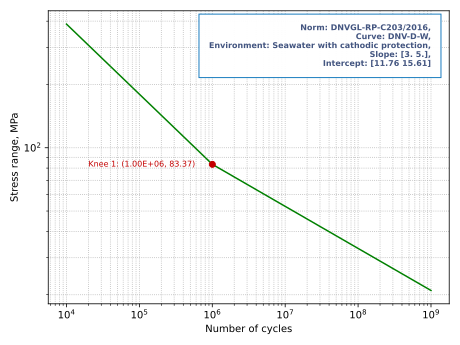

In [64]:
sn_comp

# Fatigue Damage Calculation

In [65]:
LEF = 3
scale_f = crit_detail.scaleeffect
SCF_in = crit_detail.scfin
material_SF = 1.25
damage_Factor = LEF*SEF*SCF_in*scale_f*material_SF
print(damage_Factor)

3.743878456471764


In [66]:
cc

,From complete signal
Cycle counting object,
"largest full stress range, MPa",17.034161
"largest stress range, MPa",43.390596
number of full cycles,13568
number of residuals,22
number of small cycles,0
stress concentration factor,N/A
residuals resolved,False
mean stress-corrected,No


In [67]:
scaled_cc = cc*damage_Factor
scaled_cc

,"From complete signal, SCF=3.743878456471764"
Cycle counting object,
"largest full stress range, MPa",63.773828
"largest stress range, MPa",162.449119
number of full cycles,13568
number of residuals,22
number of small cycles,0
stress concentration factor,3.743878
residuals resolved,False
mean stress-corrected,No


In [68]:
fat_dmg = pf.damage.stress_life.get_pm(scaled_cc, sn_comp)

In [69]:
fat_dmg.sum()

1.0566602147430796e-05

In [70]:
# Find all columns containing '_DEG230_'
deg230_cols = [col for col in data_processed.columns if "_DEG230_" in col]

# Select only those columns
deg230_data = data_processed[deg230_cols]

for col in deg230_data.columns:
    damage_col = col + " Damage"
    deg230_data[damage_col] = deg230_data[col].progress_apply(
        lambda cc: (
            sum(pf.damage.stress_life.get_pm(cc * damage_Factor, sn_comp))
            if cc is not None and not isinstance(cc, float) else np.nan
        )
    )


100%|██████████| 22/22 [00:00<00:00, 4658.46it/s]


In [71]:
# IEC 61400 cyclecount plot with cumulative cycles vs stress
# Fatigue spectra cycles vs stress on a SN Curve plot! comparison of fatigue spectra for different operational conditions
# Link with the defects! fatigue life beyond welds!
# approaches to fatigue life--stress life (assumption on undetectable cracks) and crack growth curve (visible crack with known params) needs paris law!
## changing the ratio of operating conditions affects the lifetime!

In [72]:
# Add case_ID column (take directly from data_processed)
deg230_data["case_ID"] = data_processed.loc[deg230_data.index, "case_ID"].values
deg230_data

,CC_TP_SG_LAT014_DEG230_0_nr1 [MPa],CC_TP_SG_LAT014_DEG230_0_nr1 [MPa] Damage,case_ID
2020-07-03 01:30:00+00:00,CC_TP_SG_LAT014_DEG230_0_nr1 [MPa] (03 Jul 202...,8.687371e-08,parked
2020-07-03 01:40:00+00:00,CC_TP_SG_LAT014_DEG230_0_nr1 [MPa] (03 Jul 202...,1.125610e-07,parked
2020-07-03 01:50:00+00:00,CC_TP_SG_LAT014_DEG230_0_nr1 [MPa] (03 Jul 202...,1.429058e-07,parked
2020-07-03 02:00:00+00:00,CC_TP_SG_LAT014_DEG230_0_nr1 [MPa] (03 Jul 202...,1.010623e-07,parked
2020-07-03 02:10:00+00:00,CC_TP_SG_LAT014_DEG230_0_nr1 [MPa] (03 Jul 202...,3.810673e-09,parked
2020-07-03 02:20:00+00:00,CC_TP_SG_LAT014_DEG230_0_nr1 [MPa] (03 Jul 202...,1.458656e-08,parked
2020-07-03 02:30:00+00:00,CC_TP_SG_LAT014_DEG230_0_nr1 [MPa] (03 Jul 202...,4.811898e-09,parked
2020-07-03 02:40:00+00:00,CC_TP_SG_LAT014_DEG230_0_nr1 [MPa] (03 Jul 202...,2.181613e-08,parked
2020-07-03 02:50:00+00:00,CC_TP_SG_LAT014_DEG230_0_nr1 [MPa] (03 Jul 202...,9.242418e-09,parked
2020-07-03 03:00:00+00:00,CC_TP_SG_LAT014_DEG230_0_nr1 [MPa] (03 Jul 202...,1.530130e-08,parked


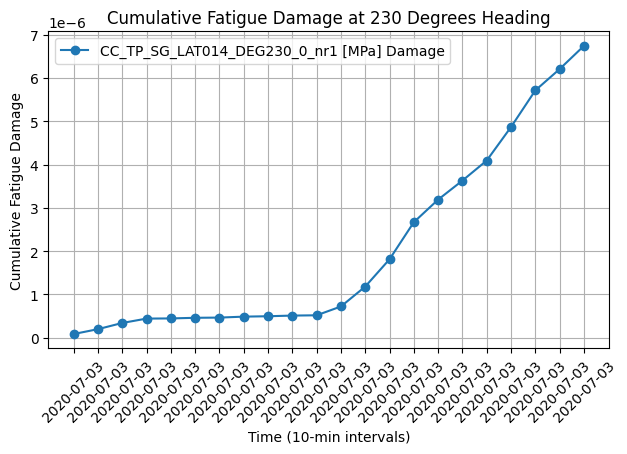

In [73]:
damage_cols = [c for c in deg230_data.columns if "Damage" in c]


# Synthetic timeline
n_steps = len(deg230_data)
new_index = pd.date_range(start="2020-07-03 01:30:00+00:00", periods=n_steps, freq="10min")
deg230_data = deg230_data.set_index(new_index)
deg230_data['cumulative damage'] = deg230_data[damage_cols].cumsum()


# plt.figure(figsize=(14, 6))
for col in damage_cols:
    plt.plot(deg230_data.index, deg230_data['cumulative damage'], label=col, marker='o',      linestyle='-' )


# # Plot each column with marker style based on case_ID
# for col in damage_cols:
#     for case_id, marker in case_markers.items():
#         mask = deg230_data["case_ID"] == case_id
#         plt.plot(
#             deg230_data.index[mask],
#             deg230_data.loc[mask, 'cumulative damage'],
#             label=f"{col} ({case_id})",
#             marker=marker,
#             linestyle="-"
#         )


# Show ticks for every 10-min interval
plt.xticks(deg230_data.index, rotation=45)

plt.xlabel("Time (10-min intervals)")
plt.ylabel("Cumulative Fatigue Damage")
plt.title("Cumulative Fatigue Damage at 230 Degrees Heading")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


In [74]:
OS_dmg_mean = deg230_data.groupby('case_ID')['CC_TP_SG_LAT014_DEG230_0_nr1 [MPa] Damage'].mean()
OS_dmg_mean

case_ID
parked    4.722959e-08
rated     5.657517e-07
Name: CC_TP_SG_LAT014_DEG230_0_nr1 [MPa] Damage, dtype: float64

## **Fatigue Lifetime Estimation**

fatigue life can be estimated as the inverse of Yearly fatige damage

In [75]:
1/(365*24*6*OS_dmg_mean['rated'])

33.62937442827673

In [76]:
1/(365*24*6*OS_dmg_mean['parked'])

402.83801811357444

We can assume proportions of operational conditions for further analysis, we can play with these two operational states to see their effects on the lifetime

In [77]:
prob_parked = 0.1
prob_rated = 1-prob_parked

In [78]:
yearly_damage = prob_rated*(365*24*6*OS_dmg_mean['rated']) + prob_parked*(365*24*6*OS_dmg_mean['parked'])
1/yearly_damage

37.0225620920888